# **Import Libraries**

In [24]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

# **Lire les données**

In [25]:
DirPath = "./data/"

In [26]:
data = pd.read_csv(DirPath + "data.csv")
genre_data = pd.read_csv(DirPath + "data_by_genres.csv")
year_data = pd.read_csv(DirPath + "data_by_year.csv")

In [27]:
data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055


In [28]:
genre_data

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1,zolo,0.222625,0.547082,2.580991e+05,0.610240,0.143872,0.204206,-11.295878,0.061088,125.494919,0.596155,33.778943,9
2969,0,zouglou,0.161000,0.863000,2.063200e+05,0.909000,0.000000,0.108000,-5.985000,0.081300,119.038000,0.845000,58.000000,7
2970,1,zouk,0.263261,0.748889,3.060728e+05,0.622444,0.257227,0.089678,-10.289222,0.038778,101.965222,0.824111,46.666667,5
2971,0,zurich indie,0.993000,0.705667,1.984173e+05,0.172667,0.468633,0.179667,-11.453333,0.348667,91.278000,0.739000,0.000000,7


In [29]:
year_data

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,1,2016,0.284171,0.600202,221396.510295,0.592855,0.093984,0.181170,-8.061056,0.104313,118.652630,0.431532,59.647190,0
96,1,2017,0.286099,0.612217,211115.696787,0.590421,0.097091,0.191713,-8.312630,0.110536,117.202740,0.416476,63.263554,1
97,1,2018,0.267633,0.663500,206001.007133,0.602435,0.054217,0.176326,-7.168785,0.127176,121.922308,0.447921,63.296243,1
98,1,2019,0.278299,0.644814,201024.788096,0.593224,0.077640,0.172616,-7.722192,0.121043,120.235644,0.458818,65.256542,1


# **La musique au fil du temps**


En utilisant les données regroupées par année, nous pouvons comprendre comment la musique a changé de 1921 à 2020.

<AxesSubplot:xlabel='decenie', ylabel='count'>

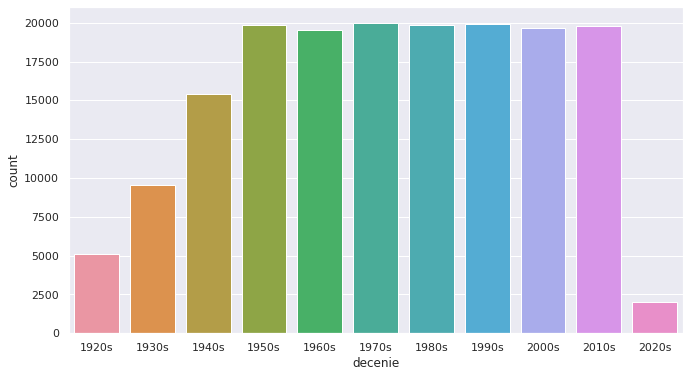

In [30]:
def get_date(year):
    start = int(year/10) * 10
    decenie = "{}s".format(start)
    return decenie

data["decenie"] = data["year"].apply(get_date)

sns.set(rc={"figure.figsize":(11 ,6)})
sns.countplot(data["decenie"])

In [31]:
sound_features = ["acousticness", "danceability", "energy", "instrumentalness", "liveness", "valence"]

In [32]:

figure = px.line(year_data, x="year", y=sound_features)
figure.show()

# **Musique en fonction des genres**

In [33]:
top_10_genres = genre_data.nlargest(10, "popularity")

figure = px.bar(top_10_genres, x="genres", y=["valence", "energy", "danceability", "acousticness"], barmode="group")
figure.show()

# **Clustering Musique avec K-Means**

In [34]:
musique_cluster = Pipeline([("scaler", StandardScaler()), 
                                  ("kmeans", KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
cl = list(X.columns)
musique_cluster.fit(X)
musique_cluster_labels = musique_cluster.predict(X)
data["cluster_label"] = musique_cluster_labels

# **Visualisaton du Clusters avec PCA**

In [ ]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([("scaler", StandardScaler()), ("PCA", PCA(n_components=2))])
s = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=["x", "y"], data=s)
projection["title"] = data["name"]
projection["cluster"] = data["cluster_label"]

figure = px.scatter(
    projection, x="x", y="y", color="cluster", hover_data=["x", "y", "title"])
figure.show()

# **Système de recommandation**

Sur la base de l`analyse et de la visualisation, il est clair que des genres similaires ont tendance à avoir des points de données proches les uns des autres, et des types de chansons similaires sont également regroupés.
On utilise cette idée pour créer un système de recommandation

In [ ]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

client_id = "f69934d4ada64841b6aac8f7b69bda70"
client_secret = "584ef5b1eebc4ef1b93896f2f272e0f0"

client_manager = SpotifyClientCredentials(client_id=client_id, 
                                                      client_secret=client_secret)                                                     
sp = spotipy.Spotify(client_credentials_manager = client_manager)

In [ ]:
def search(name, year):
    s_data = defaultdict()
    res = sp.search(q= "track: {} year: {}".format(name,year), limit=1)
    if res["tracks"]["items"] == []:
        return None

    res = res["tracks"]["items"][0]
    musique_id = res["id"]
    audio_features = sp.audio_features(musique_id)[0]

    s_data["name"] = [name]
    s_data["year"] = [year]
    s_data["explicit"] = [int(res["explicit"])]
    s_data["duration_ms"] = [res["duration_ms"]]
    s_data["popularity"] = [res["popularity"]]

    for key, value in audio_features.items():
        s_data[key] = value
    return pd.DataFrame(s_data)

In [ ]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

cl = ["valence", "year", "acousticness", "danceability", "duration_ms", "energy", "explicit",
 "instrumentalness", "key", "liveness", "loudness", "mode", "popularity", "speechiness", "tempo"]

def get_musique(musique, spotify_data):
    try:
        s_data = spotify_data[(spotify_data["name"] == musique["name"]) 
                                & (spotify_data["year"] == musique["year"])].iloc[0]
        return s_data
    except IndexError:
        return search(musique["name"], musique["year"])
        
def moyenne_vecteur(musique_list, spotify_data):
    musique_vectors = []
    for musique in musique_list:
        s_data = get_musique(musique, spotify_data)
        if s_data is None:
            print("n'existe pas")
            continue
        musique_vector = s_data[cl].values
        musique_vectors.append(musique_vector)  
    musique_matrix = np.array(list(musique_vectors))
    return np.mean(musique_matrix, axis=0)

def lists(dict_list):   
    dict = defaultdict()
    for key in dict_list[0].keys():
        dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            dict[key].append(value)
            
    return dict

In [ ]:
def recommandation( musique_list, spotify_data, n_musiques=15): 
    donne = ["name", "year", "artists"]
    musique_dict = lists(musique_list)
    
    musique_center = moyenne_vecteur(musique_list, spotify_data)
    scaler = musique_cluster.steps[0][1]
    scaled = scaler.transform(spotify_data[cl])
    scaled_musique= scaler.transform(musique_center.reshape(1, -1))
    distances = cdist(scaled_musique, scaled, "cosine")
    index = list(np.argsort(distances)[:, :n_musiques][0])
    
    rec_musiques = spotify_data.iloc[index]
    rec_musiques = rec_musiques[~rec_musiques["name"].isin(musique_dict["name"])]
    return rec_musiques[donne].to_dict(orient="records")

In [ ]:
recommandation([{"name": "Α. Nwaar Is The New Black", "year":2017},
                {"name": "B. #QuedusaalVie", "year": 2017},
                {"name": "Baltringue", "year": 2018},
                {"name": "Δ. Dieu ne ment jamais", "year": 2017},
                {"name": "Ε. Signaler", "year": 2017}],  data)

[{'name': '20 Years Later', 'year': 2018, 'artists': "['Yung Pinch']"},
 {'name': 'Virtual (Blue Balenciagas)',
  'year': 2018,
  'artists': "['YNW Melly']"},
 {'name': 'VALENTINO', 'year': 2019, 'artists': "['24kGoldn']"},
 {'name': 'My Beyoncé', 'year': 2016, 'artists': "['Lil Durk', 'DeJ Loaf']"},
 {'name': "Grass Ain't Greener", 'year': 2017, 'artists': "['Chris Brown']"},
 {'name': 'Dark Conversations', 'year': 2019, 'artists': "['Rod Wave']"},
 {'name': 'Come Closer (feat. Queen Naija)',
  'year': 2018,
  'artists': "['A Boogie Wit da Hoodie', 'Queen Naija']"},
 {'name': "Don't Wanna Breathe", 'year': 2017, 'artists': "['Kodak Black']"},
 {'name': 'Halloween', 'year': 2017, 'artists': "['Kodak Black']"},
 {'name': 'Gnarly (feat. Lil Pump)',
  'year': 2018,
  'artists': "['Kodak Black', 'Lil Pump']"},
 {'name': 'R.I.P.', 'year': 2018, 'artists': "['Playboi Carti']"},
 {'name': '911', 'year': 2018, 'artists': "['Ellise']"},
 {'name': 'Faking It (feat. Kehlani & Lil Yachty)',
  'yea